# 0.LIBRARIES and FUNCTIONS

In [3]:
%cd "C:\\Code\\ditto_v2"

C:\Code\ditto_v2


c:\Users\User\AppData\Local\Programs\Python\Python312\Lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [4]:
%pwd

'C:\\Code\\ditto_v2'

In [7]:
# import f_vg
import requests
import urllib
import pandas as pd
import numpy as np
import json

In [8]:
def remove_columns_with_value_in_row(df:pd.DataFrame, row_number:int, value_to_find:str) -> pd.DataFrame:
    
    row_to_search=df.iloc[row_number,:].values

    # Find all indices of the value
    indices = [index for index, value in enumerate(row_to_search) if value == value_to_find]

    # remove columns
    df = df.drop(columns=df.columns[indices])
    return df

# 1. INPUTS

In [9]:
import urllib

### API CALL PARAMS ###
username = "joan.guerrero.erencia@gmail.com"
password = "ZensusDB#2309"
lang     = 'de'
params = [('username', username), 
          ('password', password), 
          ('language',lang)
         ]

encoded_url = urllib.parse.urlencode(params)
print(f'encoded_url ={encoded_url}')

### TOKEN INFO ###
myToken = '4b793986dde543f6b1e58575ba1038d4'
head = {'Authorization': 'token {}'.format(myToken)}

## host1 does NOT WORK!
host1 = 'https://www-genesis.destatis.de/genesisWS/rest/2020/'
host2 = 'https://ergebnisse.zensus2022.de/api/rest/2020/'


encoded_url =username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=de


In [10]:
### ALSO WORKS!
username_encoded2 = 'joan.guerrero.erencia%40gmail%2Ecom'
password_encoded2 = 'ZensusDB%232309'
encoded_url2 = f'username={username_encoded2}&password={password_encoded2}&language=en'
print(f'encoded_url2={encoded_url2}')

encoded_url2=username=joan.guerrero.erencia%40gmail%2Ecom&password=ZensusDB%232309&language=en


In [11]:
# https://www-genesis.destatis.de/datenbank/online/statistics

d_Themen = {
    11 : 'Gebiet',
    12 : 'Bevölkerung',
    13 : 'Arbeitsmarkt',
    14 : 'Wahlen',
    # 21 : 'Gebiet',
    # 22 : 'Gebiet',
    # 23 : 'Gebiet',
    # 24 : 'Gebiet',
    # 31 : 'Gebiet',
    # 32 : 'Gebiet',
    # 33 : 'Gebiet',
    # 41 : 'Gebiet',
    # 42 : 'Gebiet',
    # 43 : 'Gebiet',
    # 44 : 'Gebiet',
    # 45 : 'Gebiet',
    # 46 : 'Gebiet',
    47 : 'Finanz- und andere Dienstleistunge',
    48 : 'Wirtschaftsbereichübergreifende Ergebnisse',
    49 : 'Andere Wirtschaftsbereiche',
    51 : 'Außenhandel',
    52 : 'Unternehmen un Arbeitsstätten',
    53 : 'Handwerk und handwerksähnliches Gewerbe',
    61 : 'Preise',
    62 : 'Verdienste, Arbeitskosten',
    63 : 'Einkommen und Ausgaben privater Haushalte',
    71 : 'Öffentliche Finanzen',
    72 : 'Steuern',
    73 : 'Personal in öffentliche Dienst',
    # 74 : 'Gebiet',
    # 79 : 'Gebiet',
    81 : 'Volkswirtschaftliche Gesamtrechnungen des Bundes',
    82 : 'Volkswirtschaftliche Gesamtrechnungen des Lander',
    # 85 : 'Gebiet',
    # 91 : 'Gebiet',
    # 99 : 'Gebiet',
}

# 2.API CALLS (DESTATIS)

### API DOKUMENTATION SUMMARY

#### Query Methods

1. **HelloWorld**: Methoden zum ersten Testen der API
Bsp: Test der Anmeldung im System mit den Zugangsdaten.

2. **Find:** Methoden zum Finden von Informationen
Bsp: Tabellen mit Daten zu „Import“

3. **Cataloque:** Methoden zum Auflisten von Objekten
Bsp: Tabellen aus der Statistik „Mikrozensus“

4. **Data:** Methoden zum Herunterladen von Daten
Bsp: Tabelle „11111-0002 – Gebietsfläche: Kreise, Stichtag“

5. **Metadata:** Methoden zum Herunterladen von Metadaten
Bsp: Statistik 11111 –Feststellung des Gebietsstandes

6. **Profile:** Methoden zur Pflege des eigenen Accounts
Bsp: Passwort ändern.


#### Query responses

1. **Ident:** Identifikation des Dienstes:
    - Service: Name des Dienstes.
    - Method: Name der Methode.
2. **Status:** Informationen zur Durchführung des Requests:
    - Code: Identifikationsnummer des Fehlers, oder „0“ im Erfolgsfall.
    - Content: beschreibt den Fehler textuell, oder „erfolgreich“ im Erfolgsfall.
    - Type: kann die Werte „Error“, „Warning“ und „Information“ annehmen.
3. **Parameter:** Zur Bearbeitung genutzte Parameter aus dem Request. (ggf. vom Dienst korrigiert)
    - username: Nutzername des GENESIS-Zugangs.
    - password: Passwort des GENESIS-Zugangs.
    - [...]: Ggf. weitere Parameter, je nach Methode.
    - language: Sprache, in der die Antwort geliefert werden soll.
4. **List** Liste der gefundenen Objekte (nur Catalogue-Dienste)
5. **Object** Gefundenes Objekt (nur Data- und Metadata-Dienste)

### `whoami`

In [12]:
url_whoami = f'helloworld/whoami'

host = host1
# host = host2

url_test = f'{host}{url_whoami}'

In [13]:
response = requests.get(url_test)
# response = requests.get(url_test, headers=head)
print(f'url={url_test},\n response={response.text}')

url=https://www-genesis.destatis.de/genesisWS/rest/2020/helloworld/whoami,
 response={"User-Agent":"python-requests/2.32.3"}


In [14]:
response = requests.get(url_test)
# response = requests.get(url_test, headers=head)
print(f'url={url_test},\n response={response.text}')

url=https://www-genesis.destatis.de/genesisWS/rest/2020/helloworld/whoami,
 response={"User-Agent":"python-requests/2.32.3"}


### `logincheck`

In [15]:
url_logincheck = f'helloworld/logincheck'

## Select host1 or host2
# host = host1
host = host2

url_test = f'{host}{url_logincheck}?{encoded_url}'
url_test2 = f'{host}{url_logincheck}?{encoded_url2}' # ALSO WORKS!

In [16]:
# response = requests.get(url_test)
response = requests.get(url_test, headers=head)
print(f'url={url_test},\n response={response.text}')

url=https://ergebnisse.zensus2022.de/api/rest/2020/helloworld/logincheck?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=de,
 response={"Status":"Sie wurden erfolgreich an- und abgemeldet! Bei mehr als 3 parallelen Requests wurden länger als 15 Minuten laufende Requests beendet.","Username":"joan.guerrero.erencia@gmail.com"}


### `find`

In [17]:
url_find = f'find/find'
# search_term='Population'
# search_term='Pop*'
search_term='73151-0003'
pagelength_max=25000

## Select host1 or host2
# host = host1
host = host2

url_test = f'{host}{url_find}?{encoded_url}&term={search_term}&category=all#&pagelength={pagelength_max}'
# url_test2 = f'{host}{url_find}?{encoded_url2}&term={search_term}&category=all&pagelength={pagelength_max}' # ALSO WORKS!

In [18]:
response = requests.get(url_test)
# response = requests.get(url_test, headers=head)
print(f'url={url_test},\n response={response.text}')

url=https://ergebnisse.zensus2022.de/api/rest/2020/find/find?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=de&term=73151-0003&category=all#&pagelength=25000,
 response={"Ident":{"Service":"find","Method":"find"},"Status":{"Code":0,"Content":"erfolgreich","Type":"Information"},"Parameter":{"username":"********************","password":"********************","term":"73151-0003","category":"Alle","pagelength":"100","language":"de"},"Cubes":null,"Statistics":null,"Tables":null,"Timeseries":null,"Variables":null,"Copyright":"© Statistische Ämter des Bundes und der Länder, Deutschland, 2025. Lizenziert unter der Datenlizenz Deutschland - Namensnennung - Version 2.0"}


In [19]:
import json

d_find = json.loads(response.text)
d_find
d_find_stat = d_find['Statistics']

d_find_stat

In [20]:
import pandas as pd
d_find_tables = d_find['Tables']# pdf_tables = pd.DataFrame(d_tables['Cubes'])

# Convert to pd df
pdf_tables = pd.DataFrame(d_find_tables)
pdf_tables#.head()
# pdf_tables[pdf_tables['Code'].str.startswith('2000X')]

""


### `catalogue/results`

In [16]:
url_catalogue_results = f'catalogue/results'

## Select host1 or host2
# host = host1
host = host2

url_test = f'{host}{url_catalogue_results}?{encoded_url}&selection=&area=all&pagelength=25000'


In [17]:
# response = requests.get(url_test)
response = requests.get(url_test, headers=head)
print(f'url={url_test},\n response={response.text}')

url=https://ergebnisse.zensus2022.de/api/rest/2020/catalogue/results?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=en&selection=&area=all&pagelength=25000,
 response={"Ident":{"Service":"catalogue","Method":"results"},"Status":{"Code":0,"Content":"successfull","Type":"information"},"Parameter":{"username":"********************","password":"********************","selection":"","area":"all","pagelength":"25000","language":"en"},"List":[{"Code":"$FullCache-1000A-0001-GEOGM1","Content":"Persons: Official population and area (municipalities)","Values":"34020"},{"Code":"$FullCache-1000A-1001-GEOBL1","Content":"Persons: Age (ten years age groups)","Values":"340"},{"Code":"$FullCache-1000A-1001-GEOGM1","Content":"Persons: Age (ten years age groups)","Values":"226820"},{"Code":"$FullCache-1000A-1001-GEOLK1","Content":"Persons: Age (ten years age groups)","Values":"8260"},{"Code":"$FullCache-1000A-1001-GEORB1","Content":"Persons: Age (ten years age groups)","Values

In [18]:
import json
import pandas as pd

d_tables = json.loads(response.text)
pdf_tables = pd.DataFrame(d_tables['List'])

# Remove part of the characters from 'column1'
pdf_tables['Code'] = pdf_tables['Code'].str.replace('$FullCache-', '')
pdf_tables['Code'] = pdf_tables['Code'].str.replace('$ShortCache-', '')

pdf_tables

,Code,Content,Values
0,1000A-0001-GEOGM1,Persons: Official population and area (municip...,34020
1,1000A-1001-GEOBL1,Persons: Age (ten years age groups),340
2,1000A-1001-GEOGM1,Persons: Age (ten years age groups),226820
3,1000A-1001-GEOLK1,Persons: Age (ten years age groups),8260
4,1000A-1001-GEORB1,Persons: Age (ten years age groups),740
...,...,...,...
2871,4000W-5004-GEOLK1,Dwellings: Type of private household - Type of...,10368
2872,5000H-3002-GEOGM1,Households: Size of private household - Type o...,210
2873,5000H-3003-GEOGM1,Households: Senior citizen status of a private...,352
2874,5000H-3005-GEOGM1,Households: Type of use of dwelling - Size of ...,252


### `catalogue/tables`

In [68]:
url_catalogue_results = f'catalogue/tables'
selection='1000X-*'
pagelength_max=500
## Select host1 or host2
# host = host1
host = host2

url_test = f'{host}{url_catalogue_results}?{encoded_url}&selection={selection}&area=all&pagelength={pagelength_max}'


In [69]:
# response = requests.get(url_test)
response = requests.get(url_test, headers=head)
print(f'url={url_test},\n response={response.text}')

url=https://ergebnisse.zensus2022.de/api/rest/2020/catalogue/tables?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=en&selection=1000X-*&area=all&pagelength=500,
 response={"Ident":{"Service":"catalogue","Method":"tables"},"Status":{"Code":0,"Content":"successfull","Type":"information"},"Parameter":{"username":"********************","password":"********************","selection":"1000X-*","area":"all","searchcriterion":"code","sortcriterion":"code","pagelength":"500","language":"en"},"List":[{"Code":"1000X-0001","Content":"Persons: Official population and area (municipalities)","Time":"2011-05-09 to 2011-05-09"},{"Code":"1000X-1001","Content":"Persons: Age (ten years age groups)","Time":"2011-05-09 to 2011-05-09"},{"Code":"1000X-1002","Content":"Persons: Age (eleven classes of years)","Time":"2011-05-09 to 2011-05-09"},{"Code":"1000X-1003","Content":"Persons: Age (five classes of years)","Time":"2011-05-09 to 2011-05-09"},{"Code":"1000X-1004","Content":"Pers

In [70]:
d_tables = json.loads(response.text)
d_tables

{'Ident': {'Service': 'catalogue', 'Method': 'tables'},
 'Status': {'Code': 0, 'Content': 'successfull', 'Type': 'information'},
 'Parameter': {'username': '********************',
  'password': '********************',
  'selection': '1000X-*',
  'area': 'all',
  'searchcriterion': 'code',
  'sortcriterion': 'code',
  'pagelength': '500',
  'language': 'en'},
 'List': [{'Code': '1000X-0001',
   'Content': 'Persons: Official population and area (municipalities)',
   'Time': '2011-05-09 to 2011-05-09'},
  {'Code': '1000X-1001',
   'Content': 'Persons: Age (ten years age groups)',
   'Time': '2011-05-09 to 2011-05-09'},
  {'Code': '1000X-1002',
   'Content': 'Persons: Age (eleven classes of years)',
   'Time': '2011-05-09 to 2011-05-09'},
  {'Code': '1000X-1003',
   'Content': 'Persons: Age (five classes of years)',
   'Time': '2011-05-09 to 2011-05-09'},
  {'Code': '1000X-1004',
   'Content': 'Persons: Age (five years age groups)',
   'Time': '2011-05-09 to 2011-05-09'},
  {'Code': '1000X

In [71]:
# d_tables = json.loads(response.text)
pdf_tables = pd.DataFrame(d_tables['List'])
pdf_tables

,Code,Content,Time
0,1000X-0001,Persons: Official population and area (municip...,2011-05-09 to 2011-05-09
1,1000X-1001,Persons: Age (ten years age groups),2011-05-09 to 2011-05-09
2,1000X-1002,Persons: Age (eleven classes of years),2011-05-09 to 2011-05-09
3,1000X-1003,Persons: Age (five classes of years),2011-05-09 to 2011-05-09
4,1000X-1004,Persons: Age (five years age groups),2011-05-09 to 2011-05-09
...,...,...,...
143,1000X-4013,Persons: Age (five years age groups)/Sex - Mar...,2011-05-09 to 2011-05-09
144,1000X-4014,Persons: Age (five years age groups) - Sex - M...,2011-05-09 to 2011-05-09
145,1000X-4015,Persons: Age (five years age groups) - Sex - M...,2011-05-09 to 2011-05-09
146,1000X-4016,Persons: Age (age classes of relevance to mark...,2011-05-09 to 2011-05-09


### `catalogue/timeseries`

### `data/result`

In [53]:
url_data_result = f'data/result'
name='12411-0001'
# pagelength_max=500
## Select host1 or host2
# host = host1
host = host2

url_test = f'{host}{url_data_result}?{encoded_url}&name={name}&area=all&compress=false'


In [57]:
response = requests.get(url_test, headers=head)
print(f'url={url_test},\n response={response.text}')

url=https://ergebnisse.zensus2022.de/api/rest/2020/data/table?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=en&name=11111-0001&area=all&compress=false,
 response={"Ident":{"Service":"data","Method":"table"},"Status":{"Code":90,"Content":"The table you requested is not available. Please check the tablecode and any selection parameter entered.","Type":"Information"},"Parameter":{"username":"********************","password":"********************","name":"11111-0001","area":"all","compress":"false","transpose":"false","contents":"","startyear":"","endyear":"","timeslices":"","regionalvariable":"","regionalkey":"","classifyingvariable1":"","classifyingkey1":"","classifyingvariable2":"","classifyingkey2":"","classifyingvariable3":"","classifyingkey3":"","classifyingvariable4":"","classifyingkey4":"","classifyingvariable5":"","classifyingkey5":"","format":"datencsv","job":"false","stand":"01.01.1970 01:00","language":"en"},"Object":null,"Copyright":"© Statistica

In [58]:
# https://wwwgenesis.destatis.de/genesisWS/rest/2020/data/result
# ?username=IHRE_KENNUNG&password=IHR_PASSWORT
# &name=12411-0001
# &area=all&compress=false&language=de

# https://ergebnisse.zensus2022.de/api/rest/2020/data/result
# ?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309
# &language=en
# &name=21111-0001
# &area=all&compress=fals

In [59]:
d_tables = json.loads(response.text)
d_tables

{'Ident': {'Service': 'data', 'Method': 'table'},
 'Status': {'Code': 90,
  'Content': 'The table you requested is not available. Please check the tablecode and any selection parameter entered.',
  'Type': 'Information'},
 'Parameter': {'username': '********************',
  'password': '********************',
  'name': '11111-0001',
  'area': 'all',
  'compress': 'false',
  'transpose': 'false',
  'contents': '',
  'startyear': '',
  'endyear': '',
  'timeslices': '',
  'regionalvariable': '',
  'regionalkey': '',
  'classifyingvariable1': '',
  'classifyingkey1': '',
  'classifyingvariable2': '',
  'classifyingkey2': '',
  'classifyingvariable3': '',
  'classifyingkey3': '',
  'classifyingvariable4': '',
  'classifyingkey4': '',
  'classifyingvariable5': '',
  'classifyingkey5': '',
  'format': 'datencsv',
  'job': 'false',
  'stand': '01.01.1970 01:00',
  'language': 'en'},
 'Object': None,
 'Copyright': '© Statistical Offices of the Federation and the Länder, Germany, 2025. Licensed

In [72]:
d_tables.keys()

dict_keys(['Ident', 'Status', 'Parameter', 'List', 'Copyright'])

In [73]:
pdf_tables = pd.DataFrame(d_tables['List'])
pdf_tables

,Code,Content,Time
0,1000X-0001,Persons: Official population and area (municip...,2011-05-09 to 2011-05-09
1,1000X-1001,Persons: Age (ten years age groups),2011-05-09 to 2011-05-09
2,1000X-1002,Persons: Age (eleven classes of years),2011-05-09 to 2011-05-09
3,1000X-1003,Persons: Age (five classes of years),2011-05-09 to 2011-05-09
4,1000X-1004,Persons: Age (five years age groups),2011-05-09 to 2011-05-09
...,...,...,...
143,1000X-4013,Persons: Age (five years age groups)/Sex - Mar...,2011-05-09 to 2011-05-09
144,1000X-4014,Persons: Age (five years age groups) - Sex - M...,2011-05-09 to 2011-05-09
145,1000X-4015,Persons: Age (five years age groups) - Sex - M...,2011-05-09 to 2011-05-09
146,1000X-4016,Persons: Age (age classes of relevance to mark...,2011-05-09 to 2011-05-09


### `data/table`

In [123]:
url_data_table = f'data/table'
# name='1000A-0000'
name='1000X-0001'               # Personen: Amtliche Einwohnerzahl und Fläche (Gemeinden)
# pagelength_max=500
## Select host1 or host2
# host = host1
host = host2

url_test = f'{host}{url_data_table}?{encoded_url}&name={name}'#&area=all&compress=false'


In [124]:
# response = requests.get(url_test)
response = requests.get(url_test, headers=head)
print(f'url={url_test},\n response={response.text}')

url=https://ergebnisse.zensus2022.de/api/rest/2020/data/table?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=de&name=1000X-0001,
 response={"Ident":{"Service":"data","Method":"table"},"Status":{"Code":0,"Content":"erfolgreich","Type":"Information"},"Parameter":{"username":"********************","password":"********************","name":"1000X-0001","area":"Öffentlich","compress":"false","transpose":"false","contents":"","startyear":"","endyear":"","timeslices":"","regionalvariable":"","regionalkey":"","classifyingvariable1":"","classifyingkey1":"","classifyingvariable2":"","classifyingkey2":"","classifyingvariable3":"","classifyingkey3":"","classifyingvariable4":"","classifyingkey4":"","classifyingvariable5":"","classifyingkey5":"","format":"datencsv","job":"false","stand":"01.01.1970 01:00","language":"de"},"Object":{"Content":"Tabelle: 1000X-0001\nPersonen: Amtliche Einwohnerzahl und Fläche (Gemeinden);;;;\nBevölkerung kompakt;;;;\n09.05.2011;;;;\n;;Perso

In [125]:
import json
response = requests.get(url_test)
tab = json.loads(response.content)['Object']['Content']
tab

'Tabelle: 1000X-0001\nPersonen: Amtliche Einwohnerzahl und Fläche (Gemeinden);;;;\nBevölkerung kompakt;;;;\n09.05.2011;;;;\n;;Personen;Fläche;Bevölkerungsdichte\n;;Anzahl;qkm;Ew/qkm\n010010000000;Flensburg, Stadt;82258;56,74;1450\n010020000000;Kiel, Landeshauptstadt;235782;118,65;1987\n010030000000;Lübeck, Hansestadt;210305;214,21;982\n010040000000;Neumünster, Stadt;77249;71,63;1078\n010510011011;Brunsbüttel, Stadt;12834;65,24;197\n010510044044;Heide, Stadt;20768;31,97;650\n010515163003;Averlak;615;9,07;68\n010515163010;Brickeln;208;6,07;34\n010515163012;Buchholz (Kreis Dithmarschen);1080;14,55;74\n010515163016;Burg (Dithmarschen);4219;11,23;376\n010515163022;Dingen;658;7,02;94\n010515163024;Eddelak;1398;9,21;152\n010515163026;Eggstedt;772;12,79;60\n010515163032;Frestedt;374;10,32;36\n010515163037;Großenrade;493;10,40;47\n010515163051;Hochdonn;1193;5,46;218\n010515163064;Kuden;637;11,36;56\n010515163089;Quickborn;201;6,95;29\n010515163097;Sankt Michaelisdonn;3618;23,05;157\n01051516311

### `data\resultfile`

In [22]:
url_data_resultfile = f'data/resultfile'
name='1000A-1001'
format='csv'
# pagelength_max=500
## Select host1 or host2
# host = host1
host = host2

url_test = f'{host}{url_data_table}?{encoded_url}&name={name}&area=all&compress=false&format={format}'

In [23]:
response = requests.get(url_test)
# response = requests.get(url_test, headers=head)
print(f'url={url_test},\n response={response.text}')

url=https://ergebnisse.zensus2022.de/api/rest/2020/data/table?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=de&name=1000A-1001&area=all&compress=false&format=csv,
 response={"Ident":{"Service":"data","Method":"table"},"Status":{"Code":0,"Content":"erfolgreich","Type":"Information"},"Parameter":{"username":"********************","password":"********************","name":"1000A-1001","area":"Alle","compress":"false","transpose":"false","contents":"","startyear":"","endyear":"","timeslices":"","regionalvariable":"","regionalkey":"","classifyingvariable1":"","classifyingkey1":"","classifyingvariable2":"","classifyingkey2":"","classifyingvariable3":"","classifyingkey3":"","classifyingvariable4":"","classifyingkey4":"","classifyingvariable5":"","classifyingkey5":"","format":"datencsv","job":"false","stand":"01.01.1970 01:00","language":"de"},"Object":{"Content":"Tabelle: 1000A-1001\nPersonen: Alter (10er-Jahresgruppen);;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;;\nBevölke

## Functions for automation

In [22]:
def get_data_table_content(url:str, table:str, is_logging:bool=False)->str:
    url_test = f'{url}?&name={table}'
    response = requests.get(url, headers=head)

    if is_logging:
        print(f'url={url_test},\n response={response.text}')

    response = requests.get(url_test)
    if response.content is not None:
        tab = json.loads(response.content)['Object']['Content']
    else:
        return None
    return tab

In [23]:
from io import StringIO
import pandas as pd

def parse_data_table(tab:str, is_logging:bool = False) -> [str,str,pd.DataFrame]:

    tab_elems = tab.split('\n',maxsplit=2)

    # Line1: Code of the table
    tab_code = tab_elems[0]  
    # Line2: Name of the table
    tab_name = tab_elems[1].split(';')[0]  
        
    tab_content = tab_elems[2]

    # Use StringIO to treat the string as a file
    data_io = StringIO(tab_content)

    # Read the string into a DataFrame
    df = pd.read_csv(data_io, sep=';', index_col=None)
    
    
    if is_logging:
        print(f'tab_code={tab_code}')
        print(f'tab_name={tab_name}')
        print(f'tab_size={df.shape}')
    return [tab_code, tab_name, df]



In [24]:
def add_destatis_table_to_dict(l_tables:list, url:str, d_tables:dict=dict(), is_logging:bool=False) -> dict:

    for i,table in enumerate(l_tables):
        print(f'[{i+1}/{len(l_tables)}] Processing table [{table}]')
        
        table_data = get_data_table_content(url=url,
                                            table=table, 
                                            is_logging=is_logging)
        
        if table_data is None:
            print(f'Table [{table}] NOT found!!!')
        else:
            [table_code, table_name, table_df] = parse_data_table(tab=table_data, 
                                                                is_logging=is_logging)
            
            d_tables[table] = {
                'code' : table_code,
                'name' : table_name,
                'df'   : table_df
            }
        
    return d_tables

In [25]:
### API CALL PARAMS ###
host2 = 'https://ergebnisse.zensus2022.de/api/rest/2020/'
username = "joan.guerrero.erencia@gmail.com"
password = "ZensusDB#2309"
lang     = 'en'
params = [('username', username), 
          ('password', password), 
          ('language',lang)
         ]

## BUILT-UP INFO
encoded_params = urllib.parse.urlencode(params)
url = f'{host2}data/table?{encoded_params}'
logging = True
l_tables = [
    # '1000A-0000',  # Personen: Bevölkerungszahl
    '1000A-0001',  # Personen: Bevölkerungszahl und Fläche (Gemeinden)
    # '1000X-0001'   # Personen: Amtliche Einwohnerzahl und Fläche (Gemeinden)
]

d_destatis = add_destatis_table_to_dict(l_tables=l_tables, url=url, is_logging=logging)

[1/1] Processing table [1000A-0001]
url=https://ergebnisse.zensus2022.de/api/rest/2020/data/table?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=en?&name=1000A-0001,
 response={"Ident":{"Service":"data","Method":"table"},"Status":{"Code":104,"Content":"There are no objects matching your selection.","Type":"Information"},"Parameter":{"username":"********************","password":"********************","name":"","area":"free","compress":"false","transpose":"false","contents":"","startyear":"","endyear":"","timeslices":"","regionalvariable":"","regionalkey":"","classifyingvariable1":"","classifyingkey1":"","classifyingvariable2":"","classifyingkey2":"","classifyingvariable3":"","classifyingkey3":"","classifyingvariable4":"","classifyingkey4":"","classifyingvariable5":"","classifyingkey5":"","format":"datencsv","job":"false","stand":"01.01.1970 01:00","language":"en"},"Object":null,"Copyright":"© Statistical Offices of the Federation and the Länder, Germany, 20

In [26]:
d_destatis = add_destatis_table_to_dict(l_tables=['1000X-0001'], url=url, d_tables=d_destatis, is_logging=logging)

[1/1] Processing table [1000X-0001]
url=https://ergebnisse.zensus2022.de/api/rest/2020/data/table?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=en?&name=1000X-0001,
 response={"Ident":{"Service":"data","Method":"table"},"Status":{"Code":104,"Content":"There are no objects matching your selection.","Type":"Information"},"Parameter":{"username":"********************","password":"********************","name":"","area":"free","compress":"false","transpose":"false","contents":"","startyear":"","endyear":"","timeslices":"","regionalvariable":"","regionalkey":"","classifyingvariable1":"","classifyingkey1":"","classifyingvariable2":"","classifyingkey2":"","classifyingvariable3":"","classifyingkey3":"","classifyingvariable4":"","classifyingkey4":"","classifyingvariable5":"","classifyingkey5":"","format":"datencsv","job":"false","stand":"01.01.1970 01:00","language":"en"},"Object":null,"Copyright":"© Statistical Offices of the Federation and the Länder, Germany, 20

In [27]:
d_destatis.keys()

dict_keys(['1000A-0001', '1000X-0001'])

In [29]:
d_destatis['1000A-0001']['df']

,Bevölkerung kompakt (Gebietsstand 15.05.2022),Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5
0,NaN,NaN,NaN,Personen,Fläche,Bevölkerungsdichte
1,NaN,NaN,NaN,Anzahl,qkm,Ew/qkm
2,15.05.2022,1.001000e+10,"Flensburg, Stadt",95015,"56,73",1675
3,15.05.2022,1.002000e+10,"Kiel, Landeshauptstadt",249132,"118,65",2100
4,15.05.2022,1.003000e+10,"Lübeck, Hansestadt",215958,"214,19",1008
...,...,...,...,...,...,...
10787,15.05.2022,1.607751e+11,"Schmölln, Stadt",13700,"94,53",145
10788,__________,NaN,NaN,NaN,NaN,NaN
10789,wiki\nNachrichtlich aus dem Gemeindeverzeichni...,NaN,NaN,NaN,NaN,NaN
10790,© Statistische Ämter des Bundes und der Länder...,NaN,NaN,NaN,NaN,NaN


In [30]:
pdf = d_destatis['1000X-0001']['df']
pdf

,Bevölkerung kompakt,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4
0,09.05.2011,NaN,NaN,NaN,NaN
1,NaN,NaN,Personen,Fläche,Bevölkerungsdichte
2,NaN,NaN,Anzahl,qkm,Ew/qkm
3,010010000000,"Flensburg, Stadt",82258,"56,74",1450
4,010020000000,"Kiel, Landeshauptstadt",235782,"118,65",1987
...,...,...,...,...,...
11341,160775050039,Ponitz,1601,"17,04",94
11342,__________,NaN,NaN,NaN,NaN
11343,Nachrichtlich aus dem Gemeindeverzeichnis GV-I...,NaN,NaN,NaN,NaN
11344,© Statistische Ämter des Bundes und der Länder...,NaN,NaN,NaN,NaN


### Function `get_catalogue()`

In [31]:
def get_catalogue(host:str, encoded_cred:str, language:str='de', is_logging:bool=False) -> pd.DataFrame:

    ## Select host1 or host2
    # host = host1
    # host = host2

    url = f'{host}catalogue/results?{encoded_cred}&selection=&area=all&pagelength=25000'
    response = requests.get(url)
    if is_logging:
        print(f'url={url},\n response={response.text}')

    d_tables = json.loads(response.text)
    pdf_tables = pd.DataFrame(d_tables['List'])

    # Remove part of the characters from 'column1'
    pdf_tables['Code'] = pdf_tables['Code'].str.replace('$FullCache-', '')
    pdf_tables['Code'] = pdf_tables['Code'].str.replace('$ShortCache-', '')
    return pdf_tables


pdf_catalogue = get_catalogue(host=host, encoded_cred=encoded_params, is_logging=logging)

url=https://ergebnisse.zensus2022.de/api/rest/2020/catalogue/results?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=en&selection=&area=all&pagelength=25000,
 response={"Ident":{"Service":"catalogue","Method":"results"},"Status":{"Code":0,"Content":"successfull","Type":"information"},"Parameter":{"username":"********************","password":"********************","selection":"","area":"all","pagelength":"25000","language":"en"},"List":[{"Code":"$FullCache-1000A-0001-GEOGM1","Content":"Persons: Official population and area (municipalities)","Values":"34020"},{"Code":"$FullCache-1000A-1001-GEOBL1","Content":"Persons: Age (ten years age groups)","Values":"340"},{"Code":"$FullCache-1000A-1001-GEOGM1","Content":"Persons: Age (ten years age groups)","Values":"226820"},{"Code":"$FullCache-1000A-1001-GEOLK1","Content":"Persons: Age (ten years age groups)","Values":"8260"},{"Code":"$FullCache-1000A-1001-GEORB1","Content":"Persons: Age (ten years age groups)","Values

In [32]:
pdf_catalogue.to_csv('./assets/Destatis/destatis_tables.csv')

### 

# 3. DATA EXTRACTION

## PARSING data in `pdf`

In [582]:
d_destatis = add_destatis_table_to_dict(l_tables=['1000A-0001'], url=url, d_tables=d_destatis, is_logging=logging)
pdf = d_destatis['1000A-0001']['df']
pdf #.head()

[1/1] Processing table [1000A-0001]
url=https://ergebnisse.zensus2022.de/api/rest/2020/data/table?username=joan.guerrero.erencia%40gmail.com&password=ZensusDB%232309&language=en?&name=1000A-0001,
 response={"Ident":{"Service":"data","Method":"table"},"Status":{"Code":104,"Content":"There are no objects matching your selection.","Type":"Information"},"Parameter":{"username":"********************","password":"********************","name":"","area":"free","compress":"false","transpose":"false","contents":"","startyear":"","endyear":"","timeslices":"","regionalvariable":"","regionalkey":"","classifyingvariable1":"","classifyingkey1":"","classifyingvariable2":"","classifyingkey2":"","classifyingvariable3":"","classifyingkey3":"","classifyingvariable4":"","classifyingkey4":"","classifyingvariable5":"","classifyingkey5":"","format":"datencsv","job":"false","stand":"01.01.1970 01:00","language":"en"},"Object":null,"Copyright":"© Statistical Offices of the Federation and the Länder, Germany, 20

,Bevölkerung kompakt (Gebietsstand 15.05.2022),Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5
0,NaN,NaN,NaN,Personen,Fläche,Bevölkerungsdichte
1,NaN,NaN,NaN,Anzahl,qkm,Ew/qkm
2,15.05.2022,1.001000e+10,"Flensburg, Stadt",95015,"56,73",1675
3,15.05.2022,1.002000e+10,"Kiel, Landeshauptstadt",249132,"118,65",2100
4,15.05.2022,1.003000e+10,"Lübeck, Hansestadt",215958,"214,19",1008
...,...,...,...,...,...,...
10787,15.05.2022,1.607751e+11,"Schmölln, Stadt",13700,"94,53",145
10788,__________,NaN,NaN,NaN,NaN,NaN
10789,wiki\nNachrichtlich aus dem Gemeindeverzeichni...,NaN,NaN,NaN,NaN,NaN
10790,© Statistische Ämter des Bundes und der Länder...,NaN,NaN,NaN,NaN,NaN


In [583]:
pdf.columns = ['Date','ARS','Name', 'Pop', 'Area','Density']
pdf = pdf.drop([0,1],axis=0)
pdf = pdf.iloc[:-4]
pdf.dtypes
pdf['Date'] = pd.to_datetime(pdf['Date'])
pdf['ARS'] = pdf['ARS'].astype('int64')

pdf

C:\Users\User\AppData\Local\Temp\ipykernel_16360\4191167170.py:5: UserWarning:

Parsing dates in %d.%m.%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.



,Date,ARS,Name,Pop,Area,Density
2,2022-05-15,10010000000,"Flensburg, Stadt",95015,"56,73",1675
3,2022-05-15,10020000000,"Kiel, Landeshauptstadt",249132,"118,65",2100
4,2022-05-15,10030000000,"Lübeck, Hansestadt",215958,"214,19",1008
5,2022-05-15,10040000000,"Neumünster, Stadt",79625,"71,66",1111
6,2022-05-15,10510011011,"Brunsbüttel, Stadt",12573,"65,21",193
...,...,...,...,...,...,...
10783,2022-05-15,160775051011,Göpfersdorf,215,"5,93",36
10784,2022-05-15,160775051023,Langenleuba-Niederhain,1722,"39,43",44
10785,2022-05-15,160775051036,Nobitz,7023,"100,37",70
10786,2022-05-15,160775052003,Dobitschen,418,"6,55",64


## OBSOLETE

In [ ]:

# # Remove the first column
# df = df.drop(df.columns[0], axis=1)

# # Remove rows that are only NaNs
# df = df.dropna(how='all')

# # Make the first row the column names
# df.iat[0,0] = tab_name

# # Remove columns, in which there is a '%' in the second row
# df = remove_columns_with_value_in_row(df=df, row_number=2, value_to_find='%')

# df.columns = df.iloc[0]
# df = df[1:].reset_index(drop=True)
# pdf = pdf.drop([,-2,-3]).reset_index(drop=True)

# # Make the first column the index
# df.set_index(df.columns[0], inplace=True)


In [115]:
tab_elems = tab.split('\n',maxsplit=2)
tab_code = tab_elems[0]  # Line1: Code of the table
tab_name = tab_elems[1]  # Line2: Name of the table
tab_name = tab_name.split(';')[0]
tab_content = tab_elems[2]
print(f'tab_code={tab_code}')
print(f'tab_name={tab_name}')
tab_content

tab_code=Tabelle: 1000X-0001
tab_name=Personen: Amtliche Einwohnerzahl und Fläche (Gemeinden)


'Bevölkerung kompakt;;;;\n09.05.2011;;;;\n;;Personen;Fläche;Bevölkerungsdichte\n;;Anzahl;qkm;Ew/qkm\n010010000000;Flensburg, Stadt;82258;56,74;1450\n010020000000;Kiel, Landeshauptstadt;235782;118,65;1987\n010030000000;Lübeck, Hansestadt;210305;214,21;982\n010040000000;Neumünster, Stadt;77249;71,63;1078\n010510011011;Brunsbüttel, Stadt;12834;65,24;197\n010510044044;Heide, Stadt;20768;31,97;650\n010515163003;Averlak;615;9,07;68\n010515163010;Brickeln;208;6,07;34\n010515163012;Buchholz (Kreis Dithmarschen);1080;14,55;74\n010515163016;Burg (Dithmarschen);4219;11,23;376\n010515163022;Dingen;658;7,02;94\n010515163024;Eddelak;1398;9,21;152\n010515163026;Eggstedt;772;12,79;60\n010515163032;Frestedt;374;10,32;36\n010515163037;Großenrade;493;10,40;47\n010515163051;Hochdonn;1193;5,46;218\n010515163064;Kuden;637;11,36;56\n010515163089;Quickborn;201;6,95;29\n010515163097;Sankt Michaelisdonn;3618;23,05;157\n010515163110;Süderhastedt;851;15,74;54\n010515166021;Diekhusen-Fahrstedt;762;7,46;102\n010515

In [122]:
from io import StringIO
import pandas as pd
# Use StringIO to treat the string as a file
data_io = StringIO(tab_content)

# Read the string into a DataFrame
df = pd.read_csv(data_io, sep=';', index_col=None)

# # Remove the first column
# df = df.drop(df.columns[0], axis=1)

# # Remove rows that are only NaNs
# df = df.dropna(how='all')

# # Make the first row the column names
# df.iat[0,0] = tab_name

# # Remove columns, in which there is a '%' in the second row
# df = remove_columns_with_value_in_row(df=df, row_number=2, value_to_find='%')

# df.columns = df.iloc[0]
# df = df[1:].reset_index(drop=True)
# df = df.drop([0, 1]).reset_index(drop=True)

# # Make the first column the index
# df.set_index(df.columns[0], inplace=True)

df

,Bevölkerung kompakt,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4
0,09.05.2011,NaN,NaN,NaN,NaN
1,NaN,NaN,Personen,Fläche,Bevölkerungsdichte
2,NaN,NaN,Anzahl,qkm,Ew/qkm
3,010010000000,"Flensburg, Stadt",82258,"56,74",1450
4,010020000000,"Kiel, Landeshauptstadt",235782,"118,65",1987
...,...,...,...,...,...
11341,160775050039,Ponitz,1601,"17,04",94
11342,__________,NaN,NaN,NaN,NaN
11343,Nachrichtlich aus dem Gemeindeverzeichnis GV-I...,NaN,NaN,NaN,NaN
11344,© Statistische Ämter des Bundes und der Länder...,NaN,NaN,NaN,NaN


In [111]:
df.loc['Insgesamt','Deutschland']

'82719540'

In [ ]:
pdf['ARS'] = pdf['ARS'].astype('str')

In [50]:
# col_merge='ARS'

In [51]:
# print(pdf.head())
# print(pdf.shape)

        Date          ARS                    Name     Pop    Area Density
2 2022-05-15  10010000000        Flensburg, Stadt   95015   56,73    1675
3 2022-05-15  10020000000  Kiel, Landeshauptstadt  249132  118,65    2100
4 2022-05-15  10030000000      Lübeck, Hansestadt  215958  214,19    1008
5 2022-05-15  10040000000       Neumünster, Stadt   79625   71,66    1111
6 2022-05-15  10510011011      Brunsbüttel, Stadt   12573   65,21     193
(10786, 6)


In [57]:
# gdf[col_merge] = gdf[col_merge].astype('str')

In [66]:
# gdf_gem = pd.merge(
#         pdf,
#         gdf,
#         on='ARS')
# # Set display option to show all columns
# pd.set_option('display.max_columns', None)
# gdf_gem

In [ ]:
print(gdf_gem.shape)
gdf_gem = gdf_gem.dropna(subset=['geometry'])
print(gdf_gem.shape)

# 4.Maps

In [584]:
color_green  = (0.0, 128.0, 0, 255.0)
color_yellow = (255.0, 255.0, 0, 255.0)
color_red    = (255.0, 0.0, 0, 255.0)
color_blue   = (0.0, 0.0, 255.0, 255.0)
color_orange = (255.0, 165.0, 0.0, 255.0)
color_light_green = (144.0, 238.0, 144.0, 255.0)
color_dark_green = (0.0, 100.0, 0.0, 255.0)

# Define a function to divide a tuple by a divisor
def divide_tuple(color_tuple, divisor):
    return tuple(value / divisor for value in color_tuple)

dict_colors = {
    4 : 'dark_green',
    3 : 'green',
    2 : 'yellow',
    1 : 'orange',
    0 : 'red',
}


dict_tuple_colors = {
    4 : color_dark_green,
    3 : color_green,
    2 : color_yellow,
    1 : color_orange,
    0 : color_red,
}

dict_tuple_colors_norm = {
    4 : divide_tuple(color_dark_green, 255),
    3 : divide_tuple(color_green, 255),
    2 : divide_tuple(color_yellow,255),
    1 : divide_tuple(color_orange,255),
    0 : divide_tuple(color_red,255),
}

# 
def get_folium_featuregroup_color(pdf: pd.DataFrame,
                                  fg_name: str,
                                    fields: list = None,
                                    aliases: list = None,
                                    is_tooltip: bool = True,  # does NOT add weight to map
                                    is_highlighted: bool = True,  # does NOT add weight to map
                                    fill_color:str = 'blue') -> folium.FeatureGroup:
    # Avoid mutable elements
    if fields is None:  # 
        fields = ['ISO_A3', 'ADMIN']
    if aliases is None:
        aliases = ['Country Code:', 'Country Name:']

    fg = folium.FeatureGroup(name=fg_name)

    # Add hover functionality_maps.
    style_function = lambda x: {'fillColor': fill_color,
                                'color': 'black',
                                'line_color': 'red',
                                'fillOpacity': 0.3,
                                'weight': 0.1}

    tooltip = None
    if is_tooltip:
        tooltip = folium.features.GeoJsonTooltip(
            fields=fields,
            aliases=aliases
        )

    highlight_function = None
    if is_highlighted:
        highlight_function = lambda x: {'fillColor': 'red',
                                        'color': 'black',
                                        'lineColor': 'red',
                                        'fillOpacity': 0.50,
                                        'weight': 0.1}

    gj = folium.GeoJson(
        data=pdf,
        # nan_fill_opacity=0.1,
        style_function=style_function,
        # line_color='black',
        highlight_function=highlight_function,
        tooltip=tooltip
    )

    fg.add_child(gj)
    return fg

In [598]:
import fiona
import geopandas as gpd
geopckg_250 = 'JupNB\DE_Data\DE_VG250.gpkg'
layers = fiona.listlayers(geopckg_250)
# print(f' layers[{len(layers)}]\n {layers}]')

lay = 'VG250_GEM'

gdf = gpd.read_file(geopckg_250, layer=lay)

crs_dest = 4326
gdf.crs = 'EPSG:25832'
print(f'Converting to WGS-84 [EPSG:4326]')
gdf = gdf.to_crs(epsg=crs_dest)
gdf.head()

print(gdf.shape)

gdf = gdf.drop_duplicates(subset=col_merge)
gdf.shape

gdf.head()
# print(gdf.dtypes)


<>:3: SyntaxWarning:

invalid escape sequence '\D'

<>:3: SyntaxWarning:

invalid escape sequence '\D'

C:\Users\User\AppData\Local\Temp\ipykernel_16360\2614159628.py:3: SyntaxWarning:

invalid escape sequence '\D'



Converting to WGS-84 [EPSG:4326]
(11119, 28)


,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,IBZ,BEM,NBD,SN_L,SN_R,SN_K,SN_V1,SN_V2,SN_G,FK_S3,NUTS,ARS_0,AGS_0,WSK,EWZ,KFL,DLM_ID,geometry
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,60,kreisfrei,ja,01,0,01,00,00,000,R,DEF01,010010000000,01001000,2008-01-01,92550,56.73,DEBKGDL20000E5MA,"MULTIPOLYGON (((9.41266 54.82264, 9.41318 54.8..."
1,DEBKGVG200000009,2022-12-20,6,4,1,010020000000,01002000,010020000000,Kiel,Stadt,60,kreisfrei,ja,01,0,02,00,00,000,R,DEF02,010020000000,01002000,2006-01-01,247717,118.65,DEBKGDL20000004J,"MULTIPOLYGON (((10.16916 54.43138, 10.16957 54..."
2,DEBKGVG20000000A,2022-12-20,6,4,1,010030000000,01003000,010030000000,Lübeck,Stadt,60,kreisfrei,ja,01,0,03,00,00,000,R,DEF03,010030000000,01003000,2006-02-01,218095,214.19,DEBKGDL20000DYMA,"MULTIPOLYGON (((10.87684 53.98737, 10.87884 53..."
3,DEBKGVG20000000B,2022-12-20,6,4,1,010040000000,01004000,010040000000,Neumünster,Stadt,60,kreisfrei,ja,01,0,04,00,00,000,R,DEF04,010040000000,01004000,1970-04-26,79502,71.66,DEBKGDL20000E4SA,"MULTIPOLYGON (((9.99545 54.14972, 9.99713 54.1..."
4,DEBKGVG20000000C,2021-11-17,6,4,1,010510011011,01051011,010510011011,Brunsbüttel,Stadt,61,--,ja,01,0,51,00,11,011,R,DEF05,010510011011,01051011,2009-01-01,12603,65.21,DEBKGDL20000E2IK,"MULTIPOLYGON (((9.16439 53.94509, 9.16706 53.9..."


In [625]:
gdf['EWZ'] = gdf['EWZ'].astype('int64')
gdf['KFL'] = gdf['KFL'].astype('int64')
gdf['EPK'] = gdf['EWZ'] / gdf['KFL'] # Einwohner pro km2

# Norm to max value
gdf['EPK_norm'] = gdf['EPK'] / gdf['EPK'].max()

gdf['EPK'] = gdf['EPK'].fillna(0)
gdf['EPK_norm'] = gdf['EPK_norm'].fillna(0)

# Replace Inf values with NaN in 'column1'
gdf['EPK_norm'] = gdf['EPK_norm'].replace([np.inf, -np.inf], np.nan)

# Drop rows with NaN values in 'column1'
gdf = gdf.dropna(subset=['EPK_norm'])


In [626]:
gdf.to_file('JupNB\DE_Data\VG250_GEM_WGS84.shp')

<>:1: SyntaxWarning:

invalid escape sequence '\D'

<>:1: SyntaxWarning:

invalid escape sequence '\D'

C:\Users\User\AppData\Local\Temp\ipykernel_16360\1984133066.py:1: SyntaxWarning:

invalid escape sequence '\D'

c:\Users\User\AppData\Local\Programs\Python\Python312\Lib\site-packages\pyogrio\raw.py:709: RuntimeWarning:

Field BEGINN create as date field, though DateTime requested.

c:\Users\User\AppData\Local\Programs\Python\Python312\Lib\site-packages\pyogrio\raw.py:709: RuntimeWarning:

Field WSK create as date field, though DateTime requested.



In [627]:
gdf_zensus_de = gpd.read_file('JupNB\DE_Data\VG250_GEM_WGS84.shp')
gdf_zensus_de.head(3)

<>:1: SyntaxWarning:

invalid escape sequence '\D'

<>:1: SyntaxWarning:

invalid escape sequence '\D'

C:\Users\User\AppData\Local\Temp\ipykernel_16360\3268194030.py:1: SyntaxWarning:

invalid escape sequence '\D'



,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,IBZ,BEM,NBD,SN_L,SN_R,SN_K,SN_V1,SN_V2,SN_G,FK_S3,NUTS,ARS_0,AGS_0,WSK,EWZ,KFL,DLM_ID,EPK,EPK_norm,geometry
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,60,kreisfrei,ja,01,0,01,00,00,000,R,DEF01,010010000000,01001000,2008-01-01,92550,56,DEBKGDL20000E5MA,1652.678571,0.0,"POLYGON ((9.41266 54.82264, 9.41318 54.82124, ..."
1,DEBKGVG200000009,2022-12-20,6,4,1,010020000000,01002000,010020000000,Kiel,Stadt,60,kreisfrei,ja,01,0,02,00,00,000,R,DEF02,010020000000,01002000,2006-01-01,247717,118,DEBKGDL20000004J,2099.296610,0.0,"POLYGON ((10.16916 54.43138, 10.16957 54.43067..."
2,DEBKGVG20000000A,2022-12-20,6,4,1,010030000000,01003000,010030000000,Lübeck,Stadt,60,kreisfrei,ja,01,0,03,00,00,000,R,DEF03,010030000000,01003000,2006-02-01,218095,214,DEBKGDL20000DYMA,1019.135514,0.0,"POLYGON ((10.87684 53.98737, 10.87884 53.98595..."


In [628]:
dict_bundeslaender_id = {
    'Schleswig-Holstein'    : '01',
    'Hamburg'               : '02',
    'Niedersachsen'         : '03',
    'Bremen'                : '04',
    'Nordrhein-Westfalen'   : '05',
    'Hessen'                : '06',
    'Rheinland-Pfalz'       : '07',
    'Baden-Württemberg'     : '08',
    'Bayern'                : '09',
    'Saarland'              : '10',
    'Berlin'                : '11',
    'Brandenburg'           : '12',
    'Mecklenburg-Vorpommern': '13',
    'Sachsen'               : '14',
    'Sachsen-Anhalt'        : '15',
    'Thüringen'             : '16'
}


In [629]:
l_states = ['Schleswig-Holstein','Bremen']

In [630]:
l_bundeslaender = [dict_bundeslaender_id[x] for x in l_states]
l_bundeslaender

['01', '04']

In [631]:
gdf_map = gdf[gdf['SN_L'].isin(l_bundeslaender)]#.drop(['BEGINN','WSK'],axis=1)
gdf_map.shape

(1110, 30)

In [632]:
## ADD PACKAGES WITH FUNCTIONALITY
import sys
sys.path.append('src/functionality_maps/')
import f_maps

In [506]:
gdf.head(1)

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,IBZ,BEM,NBD,SN_L,SN_R,SN_K,SN_V1,SN_V2,SN_G,FK_S3,NUTS,ARS_0,AGS_0,WSK,EWZ,KFL,DLM_ID,geometry
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,60,kreisfrei,ja,01,0,01,00,00,000,R,DEF01,010010000000,01001000,2008-01-01,92550,56.73,DEBKGDL20000E5MA,"MULTIPOLYGON (((9.41266 54.82264, 9.41318 54.8..."


In [652]:
Bundesland = '15' # 'Sachsen-Anhalt'
# Bundesland = '01' # 'Schleswig-Holstein'
# Bundesland = '13' # 'Mecklenburg-Vorpomern'
# # Bundesland = '11' # 'Berlin'
# Bundesland = '03' # 'Niedersachsen'
Bundesland = '09' # 'Bayern'

In [653]:
gdf.head(1)

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,IBZ,BEM,NBD,SN_L,SN_R,SN_K,SN_V1,SN_V2,SN_G,FK_S3,NUTS,ARS_0,AGS_0,WSK,EWZ,KFL,DLM_ID,geometry,EPK,EPK_norm
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,60,kreisfrei,ja,01,0,01,00,00,000,R,DEF01,010010000000,01001000,2008-01-01,92550,56,DEBKGDL20000E5MA,"MULTIPOLYGON (((9.41266 54.82264, 9.41318 54.8...",1652.678571,0.0


In [654]:
gdf_map = gdf[gdf['SN_L'] == Bundesland].drop(['BEGINN','WSK'],axis=1)
# gdf_map = gdf
gdf_map = gdf_map.reset_index(drop=True)
print(gdf_map.shape)
# gdf_map

(2229, 28)


In [655]:
gdf_map['EPK'].min()

0.0

In [656]:
gdf_map['EWZ'] = gdf_map['EWZ'].astype('int64')
gdf_map['KFL'] = gdf_map['KFL'].astype('int64')
gdf_map['EPK'] = gdf_map['EWZ'] / gdf_map['KFL'] # Einwohner pro km2

# Norm to max value
gdf_map['EPK_norm'] = gdf_map['EPK'] / gdf_map['EPK'].max()

# 2. Z-Score Normalization (Standardization)
# data = gdf_map['EPK']
# normalized_data = (data - data.mean()) / data.std()
# gdf_map['EPK_norm'] = normalized_data
# gdf_map['EPK_norm1'] = normalized_data / gdf_map['EPK_norm'].max()



# Find indices of rows with NaN values in 'column1'
nan_indices = gdf_map[gdf_map['EPK'].isna()].index.tolist()
# nan_indices

# Norm to max value
gdf_map['EPK_norm'] = gdf_map['EPK'] / gdf_map['EPK'].max()

gdf_map['EPK'] = gdf_map['EPK'].fillna(0)
gdf_map['EPK_norm'] = gdf_map['EPK_norm'].fillna(0)
# gdf_map['EPK_norm1'] = gdf_map['EPK_norm'].fillna(0)


In [657]:
# Get descriptive statistics for 'column1'
desc_stats_EPK = gdf_map.describe()
desc_stats_EPK

,ADE,GF,BSG,IBZ,EWZ,KFL,EPK,EPK_norm
count,2229.0,2229.0,2229.0,2229.000000,2.229000e+03,2229.000000,2229.000000,2229.000000
mean,6.0,4.0,1.0,62.960520,5.997933e+03,31.148497,190.328048,0.039010
std,0.0,0.0,0.0,1.270527,3.557488e+04,25.417818,320.252718,0.065639
min,6.0,4.0,1.0,60.000000,0.000000e+00,0.000000,0.000000,0.000000
25%,6.0,4.0,1.0,62.000000,1.408000e+03,15.000000,62.864000,0.012885
50%,6.0,4.0,1.0,63.000000,2.591000e+03,24.000000,100.750000,0.020650
75%,6.0,4.0,1.0,64.000000,5.150000e+03,40.000000,185.437500,0.038007
max,6.0,4.0,1.0,65.000000,1.512491e+06,310.000000,4879.003226,1.000000


In [661]:
import matplotlib.colors as mcolors

# Define a function to create RGBA tuples
def rgba_from_value(color, column, alpha_factor):
    return gdf_map.apply(lambda row: mcolors.to_rgba(color, alpha=row[column] * alpha_factor), axis=1)

gdf_map['EPK'] = gdf_map['EPK'].fillna(0)
gdf_map['EPK_norm'] = gdf_map['EPK_norm'].fillna(0)
# gdf_map['EPK_norm1'] = gdf_map['EPK_norm'].fillna(0)


# Apply the function to create RGBA tuples for column C
gdf_map['color_rgba_detailed'] = rgba_from_value('blue', 'EPK_norm', 1.0)
# gdf_map['color_rgba_detailed'] = rgba_from_value('blue', 'EPK_norm1', 1.0)


## Assign quantile distribution to a new column
# num_quant = 4
# gdf_map['quantile'] = pd.qcut(gdf_map['EPK_norm'], q=num_quant, labels=False)
## Apply the function to create RGBA tuples for column C
# gdf_map['color_rgba_tuple'] = rgba_from_value('blue', 'quantile', 1/num_quant)

# Define custom quantile boundaries
l_quantiles = [0, 0.1, 0.5, 0.9, 1.0]

# Use pd.qcut() to create uneven quantiles
gdf_map['quantile'] = pd.qcut(gdf_map['EPK_norm'], q=l_quantiles, labels=False, duplicates='drop')
print(f'max={gdf_map['quantile'].max()}')


# gdf_map['color_rgba_tuple'] = rgba_from_value('blue', 'quantile', 1.0)#1/len(l_quantiles))
# # gdf_map['color_rgba_tuple'] = rgba_from_value('blue', 'quantile', )

gdf_map['color'] = gdf_map['quantile'].map(dict_tuple_colors)
gdf_map['color_norm'] = gdf_map['quantile'].map(dict_tuple_colors_norm)
# # gdf_map['color'] = gdf_map['color'].fillna(color_blue)


gdf_map

max=3


,OBJID,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,IBZ,BEM,NBD,SN_L,SN_R,SN_K,SN_V1,SN_V2,SN_G,FK_S3,NUTS,ARS_0,AGS_0,EWZ,KFL,DLM_ID,geometry,EPK,EPK_norm,color_rgba_detailed,quantile,color,color_norm
0,DEBKGVG2000004V6,6,4,1,091610000000,09161000,091610000000,Ingolstadt,Stadt,60,kreisfrei,ja,09,1,61,00,00,000,R,DE211,091610000000,09161000,141029,133,DEBKGDL20000E5Y5,"MULTIPOLYGON (((11.40582 48.81985, 11.40629 48...",1060.368421,0.217333,"(0.0, 0.0, 1.0, 0.21733300266005934)",3,"(0.0, 128.0, 0, 255.0)","(0.0, 0.5019607843137255, 0.0, 1.0)"
1,DEBKGVG2000004V7,6,4,1,091620000000,09162000,091620000000,München,Stadt,60,kreisfrei,ja,09,1,62,00,00,000,R,DE212,091620000000,09162000,1512491,310,DEBKGDL20000E06J,"MULTIPOLYGON (((11.54637 48.22836, 11.54708 48...",4879.003226,1.000000,"(0.0, 0.0, 1.0, 1.0)",3,"(0.0, 128.0, 0, 255.0)","(0.0, 0.5019607843137255, 0.0, 1.0)"
2,DEBKGVG2000004V8,6,4,1,091630000000,09163000,091630000000,Rosenheim,Stadt,60,kreisfrei,ja,09,1,63,00,00,000,R,DE213,091630000000,09163000,64403,37,DEBKGDL20000E2LT,"MULTIPOLYGON (((12.13882 47.88229, 12.13788 47...",1740.621622,0.356758,"(0.0, 0.0, 1.0, 0.356757628774454)",3,"(0.0, 128.0, 0, 255.0)","(0.0, 0.5019607843137255, 0.0, 1.0)"
3,DEBKGVG2000004V9,6,4,1,091710111111,09171111,091710111111,Altötting,Stadt,61,--,ja,09,1,71,01,11,111,R,DE214,091710111111,09171111,13104,23,DEBKGDL20000E438,"MULTIPOLYGON (((12.63832 48.2541, 12.63964 48....",569.739130,0.116774,"(0.0, 0.0, 1.0, 0.11677367365146807)",3,"(0.0, 128.0, 0, 255.0)","(0.0, 0.5019607843137255, 0.0, 1.0)"
4,DEBKGVG2000004VA,6,4,1,091710112112,09171112,091710112112,Burghausen,Stadt,61,--,ja,09,1,71,01,12,112,R,DE214,091710112112,09171112,19364,19,DEBKGDL20000E3R6,"MULTIPOLYGON (((12.84009 48.20079, 12.84074 48...",1019.157895,0.208886,"(0.0, 0.0, 1.0, 0.20888649741943655)",3,"(0.0, 128.0, 0, 255.0)","(0.0, 0.5019607843137255, 0.0, 1.0)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2224,DEBKGVG2000006KY,6,4,1,097805742131,09780131,097805742131,Obermaiselstein,Gemeinde,64,gemeinschaftsangehörig,ja,09,7,80,57,42,131,R,DE27E,097805742131,09780131,1029,25,DEBKGDL20000E5H8,"MULTIPOLYGON (((10.25487 47.45626, 10.25658 47...",41.160000,0.008436,"(0.0, 0.0, 1.0, 0.008436149372128493)",1,"(255.0, 165.0, 0.0, 255.0)","(1.0, 0.6470588235294118, 0.0, 1.0)"
2225,DEBKGVG2000006KZ,6,4,1,097805742134,09780134,097805742134,Ofterschwang,Gemeinde,64,gemeinschaftsangehörig,ja,09,7,80,57,42,134,R,DE27E,097805742134,09780134,2071,19,DEBKGDL20000E59K,"MULTIPOLYGON (((10.25925 47.52328, 10.26055 47...",109.000000,0.022341,"(0.0, 0.0, 1.0, 0.02234062880374164)",2,"(255.0, 255.0, 0, 255.0)","(1.0, 1.0, 0.0, 1.0)"
2226,DEBKGVG2000006L0,6,4,1,097805745127,09780127,097805745127,Missen-Wilhams,Gemeinde,64,gemeinschaftsangehörig,ja,09,7,80,57,45,127,R,DE27E,097805745127,09780127,1516,34,DEBKGDL20000E59F,"MULTIPOLYGON (((10.11485 47.62673, 10.11507 47...",44.588235,0.009139,"(0.0, 0.0, 1.0, 0.00913880012586949)",1,"(255.0, 165.0, 0.0, 255.0)","(1.0, 0.6470588235294118, 0.0, 1.0)"
2227,DEBKGVG2000006L1,6,4,1,097805745144,09780144,097805745144,Weitnau,Gemeinde,64,gemeinschaftsangehörig,ja,09,7,80,57,45,144,R,DE27E,097805745144,09780144,5421,65,DEBKGDL20000E594,"MULTIPOLYGON (((10.15359 47.69157, 10.15989 47...",83.400000,0.017094,"(0.0, 0.0, 1.0, 0.017093655433321586)",1,"(255.0, 165.0, 0.0, 255.0)","(1.0, 0.6470588235294118, 0.0, 1.0)"


<Axes: >

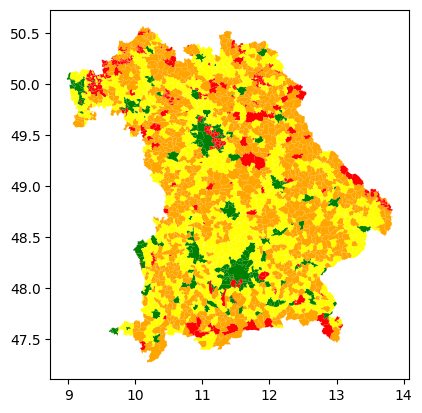

In [662]:
# gdf_map.plot(color=gdf_map['color_rgba_detailed'])  ## All normalized to largest
# gdf_map.plot(color=gdf_map['color_rgba_tuple'])     ## In buckets
gdf_map.plot(color=gdf_map['color_norm'])             ## In buckets and different colors

In [663]:
l_fg = []

for it,i in enumerate(l_quantiles):
    print(f'Processing quantile [{it}/{len(l_quantiles)}]')
    gdf_quantile = gdf_map[gdf_map['quantile'] == it]
    print(f'color={dict_colors[it]}, len gdf [{len(gdf_quantile)}]')
    if (gdf_quantile.empty is not True):
        fg = get_folium_featuregroup_color(
            pdf=gdf_quantile, 
            fg_name=f'{it+1} Quantile  [{i*100}%] [{len(gdf_quantile)}]',
            fields=['GEN','BEZ','EWZ','ARS', 'EPK', 'EPK_norm', 'quantile'],
            aliases=['Name','Type','Pop','ARS', 'Density', 'Normed density', 'Quantile'],
            fill_color=dict_colors[it]
        )
        l_fg.append(fg)

Processing quantile [0/5]
color=red, len gdf [223]
Processing quantile [1/5]
color=orange, len gdf [892]
Processing quantile [2/5]
color=yellow, len gdf [891]
Processing quantile [3/5]
color=green, len gdf [223]
Processing quantile [4/5]
color=dark_green, len gdf [0]


In [664]:
# Compute the centroid of each geometry
gdf_map['centroid'] = gdf_map['geometry'].centroid
# Extract latitude and longitude from the Point geometries
gdf_map['longitude'] = gdf_map['centroid'].x
gdf_map['latitude'] = gdf_map['centroid'].y

C:\Users\User\AppData\Local\Temp\ipykernel_16360\204242830.py:2: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




In [665]:
gdf_map.head(2)

,OBJID,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,IBZ,BEM,NBD,SN_L,SN_R,SN_K,SN_V1,SN_V2,SN_G,FK_S3,NUTS,ARS_0,AGS_0,EWZ,KFL,DLM_ID,geometry,EPK,EPK_norm,color_rgba_detailed,quantile,color,color_norm,centroid,longitude,latitude
0,DEBKGVG2000004V6,6,4,1,091610000000,09161000,091610000000,Ingolstadt,Stadt,60,kreisfrei,ja,09,1,61,00,00,000,R,DE211,091610000000,09161000,141029,133,DEBKGDL20000E5Y5,"MULTIPOLYGON (((11.40582 48.81985, 11.40629 48...",1060.368421,0.217333,"(0.0, 0.0, 1.0, 0.21733300266005934)",3,"(0.0, 128.0, 0, 255.0)","(0.0, 0.5019607843137255, 0.0, 1.0)",POINT (11.39484 48.75516),11.394836,48.755164
1,DEBKGVG2000004V7,6,4,1,091620000000,09162000,091620000000,München,Stadt,60,kreisfrei,ja,09,1,62,00,00,000,R,DE212,091620000000,09162000,1512491,310,DEBKGDL20000E06J,"MULTIPOLYGON (((11.54637 48.22836, 11.54708 48...",4879.003226,1.000000,"(0.0, 0.0, 1.0, 1.0)",3,"(0.0, 128.0, 0, 255.0)","(0.0, 0.5019607843137255, 0.0, 1.0)",POINT (11.54726 48.15321),11.547264,48.153206


In [702]:
import folium
from folium.plugins import MarkerCluster

def gen_markercluster_sum_fg (gdf, name:str, lat, lon, column_sum, maxVal):
    fg_mc = folium.FeatureGroup(name=name)

    icon_create_function = '''
        function(cluster) {
            var markers = cluster.getAllChildMarkers();
            var sum = 0;
            for (var i = 0; i < markers.length; i++) {
                sum += markers[i].options.props.population / 1000000;
                sum = Math.round(sum * 1000) / 1000;
            }
            var avg = sum;
            
            var c = ' marker-cluster-';
            if (childCount < 0.25*maxVal) {
            c += 'small';
            } 
            else if (0.25*maxVal < childCount < 0.75*maxVal) {
            c += 'medium';
            } 
            else {
            c += 'large';
            }
            

            return L.divIcon({
                html: '<b>' + avg + 'M</b>',
                className: 'marker-cluster' + c,
                iconSize: new L.Point(40, 40)
            });
        }
    '''

    marker_cluster = MarkerCluster(icon_create_function=icon_create_function)

    for index, row in gdf.iterrows():
        marker = MarkerWithProps(location=[row[lat], row[lon]], 
                    props={'population': row[column_sum]})
        marker.add_to(marker_cluster)

    marker_cluster.add_to(fg_mc)
    return fg_mc

In [703]:
gdf_map['EWZ'].max()

1512491

In [704]:
import folium


fm = folium.Map()
for fg in l_fg:
    fg.add_to(fm)

# google_maps_api_key = 'YOUR_GOOGLE_MAPS_API_KEY'
# folium.TileLayer(
#     tiles=f'https://mt1.google.com/vt/lyrs=r&x={{x}}&y={{y}}&z={{z}}&key={google_maps_api_key}',
#     attr='Google',
#     name='Google Maps',
#     overlay=True,
#     control=True
# ).add_to(fm)


# marker_cluster = MarkerCluster().add_to(fg_mc)
# for index, row in gdf_map.iterrows():
#     folium.Marker(location=[row['latitude'], row['longitude']], 
#                 #   popup=row['EWZ']
#                   popup=f"Value: {row['EWZ']}".format(row['EWZ']),
#                   tooltip=f"Sum of values in cluster: {gdf_map['EWZ'].sum()}") \
#     .add_to(marker_cluster)
# fg_mc.add_to(fm)

fg_mc = gen_markercluster_sum_fg(gdf=gdf_map, name='Einwohnerzahl',
                                 lat='latitude', lon='longitude', 
                                 column_sum = 'EWZ', maxVal = gdf_map['EWZ'].max() )
fg_mc.add_to(fm)

folium.LayerControl(position='topright',
                    collapsed=False).add_to(fm)
print('Adding layers')
fullscreen = folium.plugins.Fullscreen(position='topleft',
                                        title='Expand me',
                                        title_cancel='Exit me',
                                        force_separate_button=True)
fm.add_child(fullscreen)
print('Full screen')

fm.fit_bounds(fm.get_bounds())
print('Fitting')
fm

Adding layers
Full screen
Fitting


In [677]:
#%%
import json
import folium
from folium import Marker
from folium.plugins import MarkerCluster
from jinja2 import Template


class MarkerWithProps(Marker):
    _template = Template(u"""
        {% macro script(this, kwargs) %}
        var {{this.get_name()}} = L.marker(
            [{{this.location[0]}}, {{this.location[1]}}],
            {
                icon: new L.Icon.Default(),
                {%- if this.draggable %}
                draggable: true,
                autoPan: true,
                {%- endif %}
                {%- if this.props %}
                props : {{ this.props }} 
                {%- endif %}
                }
            )
            .addTo({{this._parent.get_name()}});
        {% endmacro %}
        """)
    def __init__(self, location, popup=None, tooltip=None, icon=None,
                 draggable=False, props = None ):
        super(MarkerWithProps, self).__init__(location=location,popup=popup,tooltip=tooltip,icon=icon,draggable=draggable)
        self.props = json.loads(json.dumps(props))    



map = folium.Map(location=[44, -73], zoom_start=4)

marker_data =(
    {
        'location':[40.67, -73.94],
        'population': 200     
    },
    {
        'location':[44.67, -73.94],
        'population': 300     
    }
)

icon_create_function = '''
    function(cluster) {
        var markers = cluster.getAllChildMarkers();
        var sum = 0;
        for (var i = 0; i < markers.length; i++) {
            sum += markers[i].options.props.population;
        }
        var avg = sum;

        return L.divIcon({
             html: '<b>' + avg + '</b>',
             className: 'marker-cluster marker-cluster-small',
             iconSize: new L.Point(20, 20)
        });
    }
'''

marker_cluster = MarkerCluster(icon_create_function=icon_create_function)

for marker_item in marker_data:
    marker = MarkerWithProps(
        location=marker_item['location'],
        props = { 'population': marker_item['population']}
    )
    marker.add_to(marker_cluster)

marker_cluster.add_to(map)    

#m.save(os.path.join('results', '1000_MarkerCluster0.html'))
map

In [667]:
import plotly.express as px

# Drop rows where 'column1' has the value 3
# gdf_no_muc = gdf_map[gdf_map['GEN'] != 'München']
# min_pop = 100000
# gdf_filt = gdf_map[gdf_map['EWZ'] > min_pop]
gdf_filt = gdf_map
# Sort the GeoDataFrame by 'EPK_norm'
gdf_map_sorted = gdf_filt.sort_values(by='EPK', ascending=True)
gdf_map_sorted['quantile'] = gdf_map_sorted['quantile'].astype('str')#.drop_duplicates().values

# Create the scatter plot
fig = px.scatter(gdf_map_sorted, x='GEN', y='EPK', 
                #  color='quantile', 
                 color='color', 
                #  labels={'color': 'Custom Legend Name'}
                 size='EWZ')

# Show the plot
fig.show()

In [ ]:
fig = px.treemap(gdf_map_sorted, x='GEN', y='EPK', 
                #  color='quantile', 
                 color='color', 
                #  labels={'color': 'Custom Legend Name'}
                 size='EWZ')

# Show the plot
fig.show()

In [572]:
import plotly.graph_objects as go

# Create the figure
fig = go.Figure()

# Create traces
for it,quant in enumerate(l_quantiles):
    # gdf_quant_values = gdf_map_sorted[gdf_map_sorted['quantile'] == it]['EPK']
    print(f'Processing quantile [{it}/{len(l_quantiles)}]')
    gdf_quantile = gdf_map_sorted[gdf_map_sorted['quantile'] == it]
    print(f'color={dict_tuple_colors[it]}, len gdf [{len(gdf_quantile)}]')
    if (gdf_quantile.empty is not True):
        trace = go.Scatter(
            x=gdf_quantile['GEN'],
            y=gdf_quantile['EPK'],
            mode='markers',
            marker=dict(
                # size=gdf_quantile['EWZ'],  # Circle sizes
                symbol='circle',         # Marker symbol set to circle
                color=dict_tuple_colors[it],            # Marker color
                # line=dict(
                #     width=2,
                #     color=dict_tuple_colors[it]
                # ) # Marker line width and color
            ),
            name=f'{it} Quantile [{quant*100}%]'  # Rename legend for the first trace
        )
        fig.add_trace(trace)

# trace2 = go.Scatter(
#     x=x,
#     y=y2,
#     mode='lines',
#     name='Custom Trace 2'  # Rename legend for the second trace
# )


# Add traces to the figure
# fig.add_trace(trace2)

# Update layout to show the legend with a custom title
fig.update_layout(
    title='EPK vs Gemeinde',
    xaxis_title='Gemeinde',
    yaxis_title='Einwohner pro km2',
    legend_title_text=f'Quantiles'
)

# Show the plot
fig.show()

Processing quantile [0/5]


KeyError: 'quantile'

In [252]:
fg = f_maps.get_folium_featuregroup(pdf=gdf_gem, 
             fg_name='yep!',
             fields=['GEN','BEZ','EWZ','ARS'],
             aliases=['Name:','Type','Pop','ARS']
             )

ValueError: Cannot render objects with any missing geometries:            Date           ARS                           Name     Pop    Area  \
0    2022-05-15  100410100100  Saarbrücken, Landeshauptstadt  179296  167,52   
1    2022-05-15  100410511511          Friedrichsthal, Stadt   10228    8,99   
2    2022-05-15  100410512512                    Großrosseln    7936   25,26   
3    2022-05-15  100410513513                     Heusweiler   18391   40,01   
4    2022-05-15  100410514514              Kleinblittersdorf   10888   27,19   
...         ...           ...                            ...     ...     ...   
2455 2022-05-15  160775051011                    Göpfersdorf     215    5,93   
2456 2022-05-15  160775051023         Langenleuba-Niederhain    1722   39,43   
2457 2022-05-15  160775051036                         Nobitz    7023  100,37   
2458 2022-05-15  160775052003                     Dobitschen     418    6,55   
2459 2022-05-15  160775052043                Schmölln, Stadt   13700   94,53   

     Density             OBJID     BEGINN  ADE  GF  BSG       AGS  \
0       1070  DEBKGVG2000006L3 2021-11-17    6   4    1  10041100   
1       1138  DEBKGVG2000006L4 2021-12-23    6   4    1  10041511   
2        314  DEBKGVG2000006L5 2021-01-07    6   4    1  10041512   
3        460  DEBKGVG2000006L6 2022-12-20    6   4    1  10041513   
4        400  DEBKGVG2000006L7 2019-08-21    6   4    1  10041514   
...      ...               ...        ...  ...  ..  ...       ...   
2455      36  DEBKGVG2000008HA 2019-08-01    6   4    1  16077011   
2456      44  DEBKGVG2000008HB 2022-12-20    6   4    1  16077023   
2457      70  DEBKGVG2000008HC 2022-12-20    6   4    1  16077036   
2458      64  DEBKGVG2000008HD 2020-12-28    6   4    1  16077003   
2459     145  DEBKGVG2000008HE 2022-12-20    6   4    1  16077043   

           SDV_ARS                     GEN       BEZ  IBZ  \
0     100410100100             Saarbrücken     Stadt   61   
1     100410511511          Friedrichsthal     Stadt   61   
2     100410512512             Großrosseln  Gemeinde   62   
3     100410513513              Heusweiler  Gemeinde   62   
4     100410514514       Kleinblittersdorf  Gemeinde   62   
...            ...                     ...       ...  ...   
2455  160775051011             Göpfersdorf  Gemeinde   64   
2456  160775051023  Langenleuba-Niederhain  Gemeinde   64   
2457  160775051036                  Nobitz  Gemeinde   64   
2458  160775052003              Dobitschen  Gemeinde   64   
2459  160775052043                Schmölln     Stadt   63   

                         BEM NBD SN_L SN_R SN_K SN_V1 SN_V2 SN_G FK_S3   NUTS  \
0                         --  ja   10    0   41    01    00  100     R  DEC01   
1                         --  ja   10    0   41    05    11  511     R  DEC01   
2                         --  ja   10    0   41    05    12  512     R  DEC01   
3                         --  ja   10    0   41    05    13  513     R  DEC01   
4                         --  ja   10    0   41    05    14  514     R  DEC01   
...                      ...  ..  ...  ...  ...   ...   ...  ...   ...    ...   
2455  gemeinschaftsangehörig  ja   16    0   77    50    51  011     R  DEG0M   
2456  gemeinschaftsangehörig  ja   16    0   77    50    51  023     R  DEG0M   
2457  gemeinschaftsangehörig  ja   16    0   77    50    51  036     R  DEG0M   
2458  gemeinschaftsangehörig  ja   16    0   77    50    52  003     R  DEG0M   
2459  gemeinschaftsangehörig  ja   16    0   77    50    52  043     R  DEG0M   

             ARS_0     AGS_0        WSK     EWZ     KFL            DLM_ID  \
0     100410100100  10041100 2009-01-01  181959  167.52  DEBKGDL20000DZN8   
1     100410511511  10041511 2009-01-01    9958    8.99  DEBKGDL20000DY16   
2     100410512512  10041512 2009-01-01    7939   25.26  DEBKGDL20000E5FK   
3     100410513513  10041513 2009-01-01   18138   40.01  DEBKGDL20000E68Y   
4     100410514514  10041514 2009-01-01   10747   27.19  DEBKGDL20000DZMZ   
...            ...       ...        ...     ...     ...               ...   
2455  160775051011  16077011 2018-07-06     221    5.92  DEBKGDL2000154RM   
2456  160775051023  16077023 2018-07-06    1739   39.43  DEBKGDL2000154RG   
2457  160775051036  16077036 2018-07-06    7127  100.37  DEBKGDL2000154RF   
2458  160775052003  16077003 2019-01-01     419    6.55  DEBKGDL200015MYG   
2459  160775052043  16077043 2019-01-01   13684   94.53  DEBKGDL200015MXP   

                                               geometry  
0     MULTIPOLYGON (((6.98294 49.32067, 6.98641 49.3...  
1     MULTIPOLYGON (((7.08765 49.34412, 7.08896 49.3...  
2     MULTIPOLYGON (((6.82824 49.21532, 6.83038 49.2...  
3     MULTIPOLYGON (((6.94548 49.37669, 6.94785 49.3...  
4     MULTIPOLYGON (((7.1037 49.18029, 7.11204 49.17...  
...                                                 ...  
2455  MULTIPOLYGON (((12.59485 50.9307, 12.59863 50....  
2456  MULTIPOLYGON (((12.52054 50.99951, 12.52271 50...  
2457  MULTIPOLYGON (((12.49897 51.00225, 12.49957 51...  
2458  MULTIPOLYGON (((12.28787 50.96787, 12.29072 50...  
2459  MULTIPOLYGON (((12.38381 50.95349, 12.3884 50....  

[2460 rows x 33 columns]

In [509]:
fm.save(f'map_zensus2022.html')

In [428]:
## https://daten.gdz.bkg.bund.de/produkte/vg/

import fiona
import geopandas as gpd
geopckg_250 = 'JupNB\DE_Data\DE_VG250.gpkg'
# print(f'file=[{geopckg_250}]')
# gdf250 = gpd.read_file(geopckg_250)
# print(gdf250.shape)  # ADM1/2/3/4/5

layers = fiona.listlayers(geopckg_250)
print(f' layers[{len(layers)}]\n {layers}]')

lay = 'VG250_GEM'

gdf = gpd.read_file(geopckg_250, layer=lay)
print(gdf.shape)
# for layer in layers:
#     gdf = gpd.read_file(geopckg_250, layer=layer)
#     print(f'layer [{layer}], shape [{gdf.shape}]')
#     # Process the GeoDataFrame as needed

# l_adm = ['ADM_ADM_0', 'ADM_ADM_1', 'ADM_ADM_2']

# geopckg1000 = './JupNB/DE_Data/DE_VG1000.gpkg'
# print(f'file=[{geopckg1000}]')
# gdf1000 = gpd.read_file(geopckg1000)
# fiona.listlayers(gdf1000)
# print(gdf1000.shape)  # Deutschland, (10, 26)

dict_vg250 = {
    'VG250_STA': 'Staat',
    'VG250_LAN': 'Bundesländer',
    'VG250_RBZ': 'Regierungsbezirke',
    'VG250_KRS': 'Kreise',
    'VG250_VWG': 'Verwaltungsgemeinschaften',
    'VG250_GEM': 'Gemeinden',
    'VG250_GEW': 'Gemeindefreie Gewässerflächen'
}

<>:3: SyntaxWarning: invalid escape sequence '\D'
<>:3: SyntaxWarning: invalid escape sequence '\D'
C:\Users\User\AppData\Local\Temp\ipykernel_9736\1192320305.py:3: SyntaxWarning: invalid escape sequence '\D'
  geopckg_250 = 'JupNB\DE_Data\DE_VG250.gpkg'


 layers[42]
 ['vg250_vwg', 'vg250_sta', 'vg250_rbz', 'vg250_pk', 'vg250_li', 'vg250_lan', 'vg250_krs', 'vg250_gem', 'v_vg250_gem', 'v_vg250_vwg', 'v_vg250_krs', 'v_vg250_rbz', 'v_vg250_lan', 'v_vg250_sta', 'v_vg250_li', 'v_vg250_pk', 'v_vg250_f', 'v_vz250_gem', 'vgtb_vz_gem', 'vgtb_rgs_vg', 'vgtb_rgs_otl', 'vgtb_azb_vg', 'vg_werte', 'vg_ibz', 'vg_daten', 'v_at_vg', 'v_vgtb_att_vg', 'v_vgtb_azb_vg', 'v_vgtb_rgs_vg', 'v_vgtb_rgs_otl', 'v_vg_ibz', 'v_vg_sn_zahl', 'v_werte_agz', 'v_werte_rdg', 'v_werte_gm5', 'v_werte_gmk', 'v_werte_ade', 'v_werte_gf', 'v_werte_bsg', 'v_werte_nbd', 'v_werte_fks3', 'v_werte_spr']]
(11119, 28)


In [429]:
gdf

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,SN_G,FK_S3,NUTS,ARS_0,AGS_0,WSK,EWZ,KFL,DLM_ID,geometry
0,DEBKGVG200000008,2022-12-20,6,4,1,010010000000,01001000,010010000000,Flensburg,Stadt,...,000,R,DEF01,010010000000,01001000,2008-01-01,92550,56.73,DEBKGDL20000E5MA,"MULTIPOLYGON (((526513.753 6075133.412, 526547..."
1,DEBKGVG200000009,2022-12-20,6,4,1,010020000000,01002000,010020000000,Kiel,Stadt,...,000,R,DEF02,010020000000,01002000,2006-01-01,247717,118.65,DEBKGDL20000004J,"MULTIPOLYGON (((575841.569 6032148.032, 575869..."
2,DEBKGVG20000000A,2022-12-20,6,4,1,010030000000,01003000,010030000000,Lübeck,Stadt,...,000,R,DEF03,010030000000,01003000,2006-02-01,218095,214.19,DEBKGDL20000DYMA,"MULTIPOLYGON (((623056.151 5983746.445, 623191..."
3,DEBKGVG20000000B,2022-12-20,6,4,1,010040000000,01004000,010040000000,Neumünster,Stadt,...,000,R,DEF04,010040000000,01004000,1970-04-26,79502,71.66,DEBKGDL20000E4SA,"MULTIPOLYGON (((565015.652 6000637.513, 565128..."
4,DEBKGVG20000000C,2021-11-17,6,4,1,010510011011,01051011,010510011011,Brunsbüttel,Stadt,...,011,R,DEF05,010510011011,01051011,2009-01-01,12603,65.21,DEBKGDL20000E2IK,"MULTIPOLYGON (((510789.928 5977425.102, 510965..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11114,DEBKGVG2000008KV,2015-06-18,6,2,1,130755561106,13075106,130755561106,Peenemünde,Gemeinde,...,106,R,DE80N,130755561106,13075106,2011-09-04,0,0.00,DEBKGDL20000XZDD,"MULTIPOLYGON (((811327.052 6008969.543, 811175..."
11115,DEBKGVG2000008KW,2020-08-27,6,2,1,130755562056,13075056,130755562056,Kamminke,Gemeinde,...,056,R,DE80N,130755562056,13075056,2011-09-04,0,0.00,DEBKGDL200015TXP,"MULTIPOLYGON (((842401.587 5981386.398, 842431..."
11116,DEBKGVG2000008KX,2015-06-18,6,2,1,130755562135,13075135,130755562135,Ückeritz,Gemeinde,...,135,R,DE80N,130755562135,13075135,2011-09-04,0,0.00,DEBKGDL20000XZEA,"MULTIPOLYGON (((830441.294 5995251.648, 830120..."
11117,DEBKGVG2000008KY,2019-08-15,6,2,1,130755562137,13075137,130755562137,Usedom,Stadt,...,137,R,DE80N,130755562137,13075137,2011-09-04,0,0.00,DEBKGDL20000SRPG,"MULTIPOLYGON (((824139.316 5980377.993, 823931..."


In [ ]:
geopckg5000 = './JupNB/DE_Data/DE_VG5000.gpkg'
gdf5000 = gpd.read_file(geopckg5000)
print(gdf5000.shape)  # Deutschland, (4594, 25)

c:\Users\User\AppData\Local\Programs\Python\Python312\Lib\site-packages\pyogrio\geopandas.py:261: UserWarning: More than one layer found in 'DE_VG5000.gpkg': 'vg5000_vwg' (default), 'vg5000_sta', 'vg5000_rbz', 'vg5000_li', 'vg5000_lan', 'vg5000_krs', 'vg5000_gem', 'v_vg5000_gem', 'v_vg5000_vwg', 'v_vg5000_krs', 'v_vg5000_rbz', 'v_vg5000_lan', 'v_vg5000_sta', 'v_vg5000_li', 'v_vg5000_f', 'v_vz5000_gem', 'vgtb_vz_gem', 'vgtb_rgs_vg', 'vgtb_azb_vg', 'vg_werte', 'vg_ibz', 'vg_daten', 'v_at_vg', 'v_vgtb_att_vg', 'v_vgtb_azb_vg', 'v_vgtb_rgs_vg', 'v_vg_ibz', 'v_vg_sn_zahl', 'v_werte_agz', 'v_werte_rdg', 'v_werte_gm5', 'v_werte_gmk', 'v_werte_ade', 'v_werte_gf', 'v_werte_bsg', 'v_werte_nbd', 'v_werte_fks3', 'v_werte_spr'. Specify layer parameter to avoid this warning.
  result = read_func(


(4594, 25)


In [410]:
gdf5000

,OBJID,BEGINN,ADE,GF,BSG,ARS,AGS,SDV_ARS,GEN,BEZ,...,SN_K,SN_V1,SN_V2,SN_G,FK_S3,NUTS,ARS_0,AGS_0,WSK,geometry
0,DEBKGVG5000008W4,2019-10-04,5,9,1,010010000,--------,010010000000,Flensburg,Amtsfreie Gemeinde,...,01,00,00,000,R,DEF01,010010000000,--------,2008-01-01,"MULTIPOLYGON (((531633.213 6075130.547, 532385..."
1,DEBKGVG5000008W5,2019-10-04,5,9,1,010020000,--------,010020000000,Kiel,Amtsfreie Gemeinde,...,02,00,00,000,R,DEF02,010020000000,--------,2006-01-01,"MULTIPOLYGON (((575109.999 6031870.053, 575829..."
2,DEBKGVG5000008W6,2019-10-04,5,9,1,010030000,--------,010030000000,Lübeck,Amtsfreie Gemeinde,...,03,00,00,000,R,DEF03,010030000000,--------,2006-02-01,"MULTIPOLYGON (((621250.836 5983463.205, 620859..."
3,DEBKGVG5000008W7,2019-10-04,5,9,1,010040000,--------,010040000000,Neumünster,Amtsfreie Gemeinde,...,04,00,00,000,R,DEF04,010040000000,--------,1970-04-26,"MULTIPOLYGON (((564022.128 6000401.822, 564959..."
4,DEBKGVG5000008W8,2019-10-04,5,9,1,010510011,--------,010510011011,Brunsbüttel,Amtsfreie Gemeinde,...,51,00,11,000,R,DEF05,010510011000,--------,2009-01-01,"MULTIPOLYGON (((507163.312 5976634.451, 507870..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4589,DEBKGVG500000CH2,2020-11-08,5,9,1,160775005,--------,160775005042,Rositz,Verwaltungsgemeinschaft,...,77,50,05,000,R,DEG0M,160775005000,--------,2019-01-01,"MULTIPOLYGON (((735080.58 5659266.289, 736721...."
4590,DEBKGVG500000CH3,2021-06-20,5,9,1,160775009,--------,160775052043,Oberes Sprottental,Verwaltungsgemeinschaft,...,77,50,09,000,R,DEG0M,160775009000,--------,2019-01-01,"MULTIPOLYGON (((728990.538 5635629.752, 728727..."
4591,DEBKGVG500000CH4,2019-10-04,5,9,1,160775050,--------,160775050012,Gößnitz,Erfüllende Gemeinde,...,77,50,50,000,R,DEG0M,160775050000,--------,2009-01-01,"MULTIPOLYGON (((738931.749 5641664.862, 738905..."
4592,DEBKGVG500000CH5,2019-10-04,5,9,1,160775051,--------,160775051036,Nobitz,Erfüllende Gemeinde,...,77,50,51,000,R,DEG0M,160775051000,--------,2018-07-06,"MULTIPOLYGON (((754479.698 5645978.294, 754168..."


In [ ]:
print('\nADM=5/LOCALITY')
gv_df60_adm5_read = pd.read_csv(path_df60_adm5, header=[0,1], index_col=0)
gv_df60_adm5_read = f_gv.handle_col_names(df=gv_df60_adm5_read, n_clear=6)
gv_df60_adm5_read.columns = ['_'.join(col) for col in gv_df60_adm5_read.columns]
print(f'shape(gv100_sa60)={gv_df60_adm5_read.shape}')